<a href="https://colab.research.google.com/github/Turdil/curso_ciencia_dados/blob/main/CursoC_Dados0.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [19]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [20]:
import os
import pandas as pd
from IPython.display import HTML
import plotly.express as px
import numpy as np

In [21]:
df = pd.read_csv('/content/drive/MyDrive/arquivo_csv/cat_acidentes.csv', sep= ';')

df

,data_extracao,predial1,queda_arr,data,feridos,feridos_gr,mortes,morte_post,fatais,auto,...,longitude,latitude,log1,log2,tipo_acid,dia_sem,hora,noite_dia,regiao,consorcio
0,2024-09-01 01:32:36,0.0,0.0,2020-10-17 00:00:00,1,0,0,0,0,3,...,0.000000e+00,0.000000e+00,R MARCOS MOREIRA,R GASTON ENGLERT,ABALROAMENTO,SÁBADO,19:00:00.0000000,NOITE,NORTE,NaN
1,2024-09-01 01:32:36,6699.0,0.0,2019-01-01 00:00:00,1,0,0,0,0,3,...,-8.178406e+08,1.295680e+09,AV ASSIS BRASIL,NaN,ABALROAMENTO,TERÇA-FEIRA,02:45:00.0000000,NOITE,NORTE,NaN
2,2024-09-01 01:32:36,411.0,0.0,2019-01-01 00:00:00,1,0,0,0,0,2,...,-8.267608e+08,1.292030e+09,R DR BARROS CASSAL,NaN,ABALROAMENTO,TERÇA-FEIRA,07:36:00.0000000,DIA,CENTRO,NaN
3,2024-09-01 01:32:36,1500.0,0.0,2019-01-01 00:00:00,4,2,0,0,0,1,...,-8.272275e+08,1.285404e+09,AV FABIO ARAUJO SANTOS,NaN,CHOQUE,TERÇA-FEIRA,16:50:00.0000000,DIA,SUL,NaN
4,2024-09-01 01:32:36,8799.0,0.0,2019-01-01 00:00:00,5,0,0,0,0,3,...,-8.201465e+08,1.288712e+09,AV IPIRANGA,NaN,COLISÃO,TERÇA-FEIRA,19:00:00.0000000,NOITE,LESTE,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
72944,2024-09-01 01:32:36,377.0,0.0,2024-08-24 00:00:00,2,0,0,0,0,1,...,-5.112389e+01,-3.002318e+01,AV DEZ DE MAIO,NaN,COLISÃO,SÁBADO,23:15:00.0000000,NOITE,NORTE,NaN
72945,2024-09-01 01:32:36,1373.0,0.0,2024-08-24 00:00:00,1,0,0,0,0,1,...,-5.115155e+01,-3.002278e+01,AV FORTE,NaN,NAO CADASTRADO,SÁBADO,23:40:00.0000000,NOITE,NORTE,NaN
72946,2024-09-01 01:32:36,766.0,0.0,2024-08-25 00:00:00,1,0,0,0,0,1,...,-5.121469e+01,-3.007395e+01,R SEPE TIARAJU,NaN,ABALROAMENTO,DOMINGO,02:15:00.0000000,NOITE,SUL,NaN
72947,2024-09-01 01:32:36,4149.0,0.0,2024-08-25 00:00:00,0,0,0,0,0,1,...,-5.117043e+01,-3.004089e+01,AV PROTASIO ALVES,NaN,CHOQUE,DOMINGO,05:08:00.0000000,NOITE,LESTE,NaN


In [22]:
import folium
from folium.plugins import HeatMap

In [23]:
print(df[['latitude', 'longitude']].isnull().sum())

# Remove as linhas que contêm NaN
df = df.dropna(subset=['latitude', 'longitude'])

# Cria o mapa
mapa = folium.Map(location=[-30.1, -51.15], zoom_start=11)
coordenadas = df[['latitude', 'longitude']].values.tolist()
mapa_calor = HeatMap(coordenadas, radius=9, blur=10)
mapa.add_child(mapa_calor)

# Exibe o mapa
mapa

latitude     10206
longitude    10206
dtype: int64


In [24]:
from folium.plugins import MarkerCluster

In [25]:
mapa = folium.Map(location=[-30.1, -51.15], zoom_start=11)
mapa_cluster = MarkerCluster(coordenadas)
mapa.add_child(mapa_cluster)

mapa

In [26]:
df.data

,data
0,2020-10-17 00:00:00
1,2019-01-01 00:00:00
2,2019-01-01 00:00:00
3,2019-01-01 00:00:00
4,2019-01-01 00:00:00
...,...
72944,2024-08-24 00:00:00
72945,2024-08-24 00:00:00
72946,2024-08-25 00:00:00
72947,2024-08-25 00:00:00


In [27]:
df['data'] = pd.to_datetime(df['data'])
df_ano = df['data'].dt.year.value_counts().sort_index()
df_ano

<ipython-input-27-d2dae4af76cb>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['data'] = pd.to_datetime(df['data'])


,count
data,
2019,12444
2020,2896
2021,11700
2022,13326
2023,14569
2024,7807
2202,1


In [28]:
df_ano = df_ano.drop(2202)
df_ano


,count
data,
2019,12444
2020,2896
2021,11700
2022,13326
2023,14569
2024,7807


In [29]:
import matplotlib.pyplot as plt


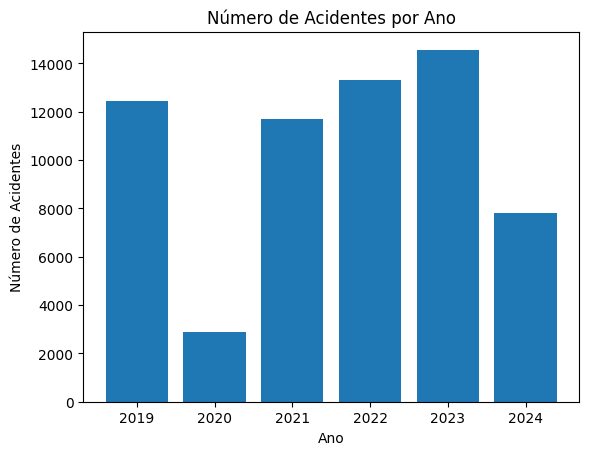

In [30]:
plt.bar(df_ano.index, df_ano.values)
plt.xlabel('Ano')
plt.ylabel('Número de Acidentes')
plt.title('Número de Acidentes por Ano')
plt.show()


In [31]:
df_ano / df_ano.max()

,count
data,
2019,0.854142
2020,0.198778
2021,0.803075
2022,0.914682
2023,1.000000
2024,0.535864


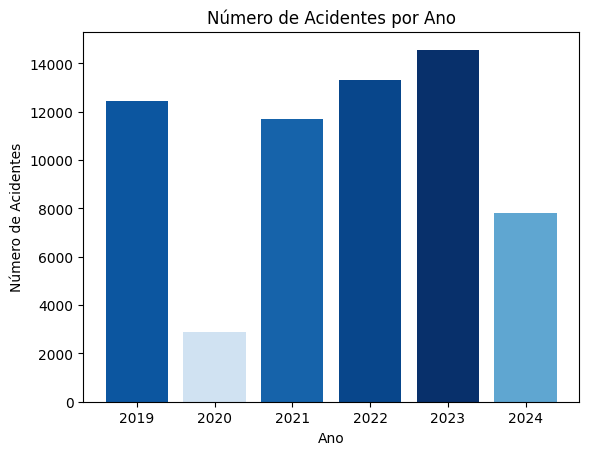

In [32]:
gradiente = df_ano / df_ano.max()
cores = plt.cm.Blues(gradiente)

plt.bar(df_ano.index, df_ano.values, color=cores)
plt.xlabel('Ano')
plt.ylabel('Número de Acidentes')
plt.title('Número de Acidentes por Ano')
plt.show()